# Monet Style Image Generation using Generative Adversarial Networks

## Project Overview

This deep learning project aims to develop a Generative Adversarial Network (GAN) capable of creating authentic Monet-style paintings that are visually indistinguishable from the master's original works. The objective is to generate between 7,000 to 10,000 high-quality images that capture Claude Monet's distinctive impressionist style and artistic characteristics.

## Dataset Description

The project utilizes a comprehensive dataset consisting of:

- **Monet Paintings**: 300 authentic Claude Monet artworks in 256×256 pixel resolution (JPEG format)
- **Photographic Images**: 7,028 general photographs in 256×256 pixel resolution (JPEG format)
- **TFRecords Format**: Both painting and photo datasets are also provided in TensorFlow's optimized TFRecords format for enhanced processing efficiency

## Methodology

### Approach Selection
While two primary approaches are viable for this task:
1. **Style Transfer**: Converting existing photographs to Monet's artistic style
2. **Pure Generation**: Creating entirely new images in Monet's style from noise

This project adopts the **pure generation approach**, focusing on training a GAN to learn and reproduce Monet's artistic patterns, color palettes, and brushstroke characteristics without relying on source photographs.

### Technical Implementation
- **Framework**: TensorFlow will be utilized for model development and training
- **Data Format**: TFRecords format will be employed to optimize data loading and processing speeds
- **Architecture**: GAN-based architecture designed to capture the nuanced artistic style of Claude Monet
- **Evaluation Criteria**: Generated images must be sophisticated enough to potentially fool trained classifiers designed to distinguish between authentic and synthetic Monet paintings

## Project Goals

The successful completion of this project will demonstrate the capability of modern generative models to learn and replicate complex artistic styles, contributing to the broader understanding of AI applications in creative domains and style transfer techniques.

In [1]:
import numpy as np
import pandas as pd
import os
from PIL import Image
import matplotlib.pyplot as plt
import time
import tensorflow as tf
from tensorflow.keras import layers
import shutil

2025-06-21 21:28:54.444549: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750541334.645033      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750541334.706022      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


## Exploratory Data Analysis (EDA) — Data Inspection, Visualization and Preprocessing

This section focuses on comprehensive data exploration and validation to ensure data quality and understand the characteristics of our dataset. The exploratory analysis will encompass the following key activities:

- **Data Accessibility Verification**: Confirm that all dataset files are properly accessible and can be loaded without errors
- **Dataset Size Validation**: Verify the expected dataset composition of 300 Monet paintings and 7,028 photographic images
- **Visual Data Inspection**: Examine representative samples from both the painting and photograph collections to understand visual characteristics and data quality
- **Color Distribution Analysis**: Perform comparative analysis of color intensity patterns between Monet paintings and photographs to identify distinctive stylistic features

In [2]:
# Image count function:
def count_images_in_folder(folder_path):

    # List of image file extensions you want to check for
    image_extensions = ('.jpg', ) # '.jpeg', '.png', '.gif', '.bmp', '.tiff', '.webp'
    
    # Get a list of files in the directory
    files_in_folder = os.listdir(folder_path)
    
    # Count files that end with any of the image extensions
    image_count = sum(1 for file in files_in_folder if file.lower().endswith(image_extensions))
    
    return image_count

In [3]:
# Compare normalised colour range function:
def compare_image_colors_normalized(path1, path2):

    def get_avg_colors(image_folder):
        image_files = [os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith(('png', 'jpg', 'jpeg'))]
        avg_colors = []
        for file in image_files:
            with Image.open(file) as img:
                img = img.convert('RGB')
                data = np.array(img)
                mean_color = data.mean(axis=(0, 1))
                avg_colors.append(mean_color)
        return np.array(avg_colors)
    
    # Get average colors for both directories
    avg_colors1 = get_avg_colors(path1)  # Pictures
    avg_colors2 = get_avg_colors(path2)  # Paintings
    
    # Plotting
    fig, axes = plt.subplots(3, 1, figsize=(8, 10), sharex=True)
    color_labels = ['Red', 'Green', 'Blue']
    dark_shades = ['darkred', 'darkgreen', 'darkblue']  # Darker shades for pictures
    pastel_shades = ['salmon', 'lightgreen', 'lightblue']  # Pastel shades for paintings
    
    for i in range(3):
        axes[i].hist(avg_colors1[:, i], bins=30, alpha=0.7, label='Pictures', color=dark_shades[i], density=True)
        axes[i].hist(avg_colors2[:, i], bins=30, alpha=0.7, label='Paintings', color=pastel_shades[i], density=True, linestyle='dashed')
        axes[i].set_title(f'Normalized Comparison of {color_labels[i]} Channel')
        axes[i].legend(loc='upper right')

    plt.tight_layout()
    plt.show()

In [4]:
# Display image function:
def display_images(path):
  
    # List all JPEG files in the specified directory
    files = [os.path.join(path, f) for f in os.listdir(path) if f.endswith('.jpg')]
    
    # Select the first 9 images (or fewer if not enough images are available)
    files = files[:9]
    
    # Set up the figure and axes for a 3x3 grid
    fig, axes = plt.subplots(3, 3, figsize=(10, 10))
    axes = axes.ravel()
    
    # Loop over the files and the axes
    for ax, img_path in zip(axes, files):
        # Open and display the image
        img = Image.open(img_path)
        ax.imshow(img)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(os.path.basename(img_path))
    
    # Hide any unused axes if there are less than 9 images
    for ax in axes[len(files):]:
        ax.axis('off')
    
    plt.tight_layout()
    plt.show()

In [5]:
# Overview of available files
Input = '/kaggle/input/gan-getting-started'
print(os.listdir(Input))

['monet_jpg', 'photo_tfrec', 'photo_jpg', 'monet_tfrec']


In [6]:
# Count number of pictures
count_images_in_folder(Input + '/photo_jpg')

7038

In [7]:
# Count number of paintings
count_images_in_folder(Input + '/monet_jpg')

300

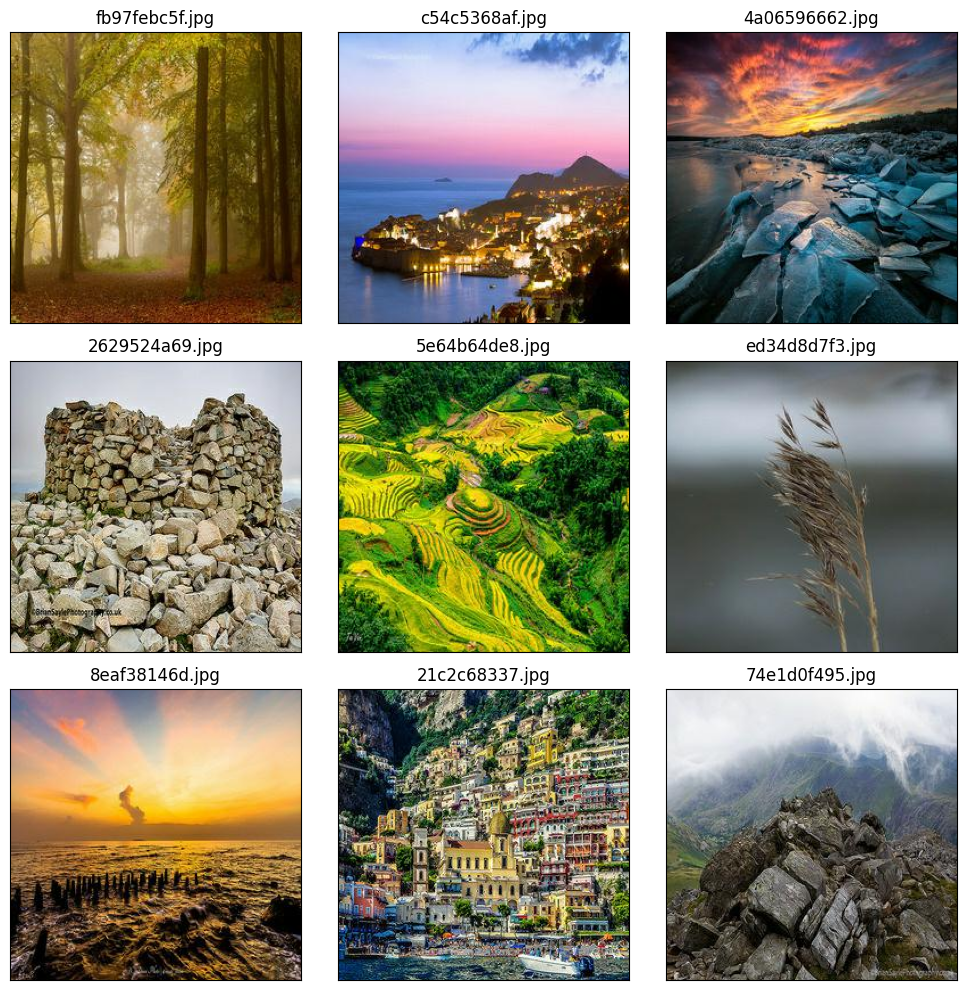

In [8]:
# Photo
display_images(Input + '/photo_jpg')

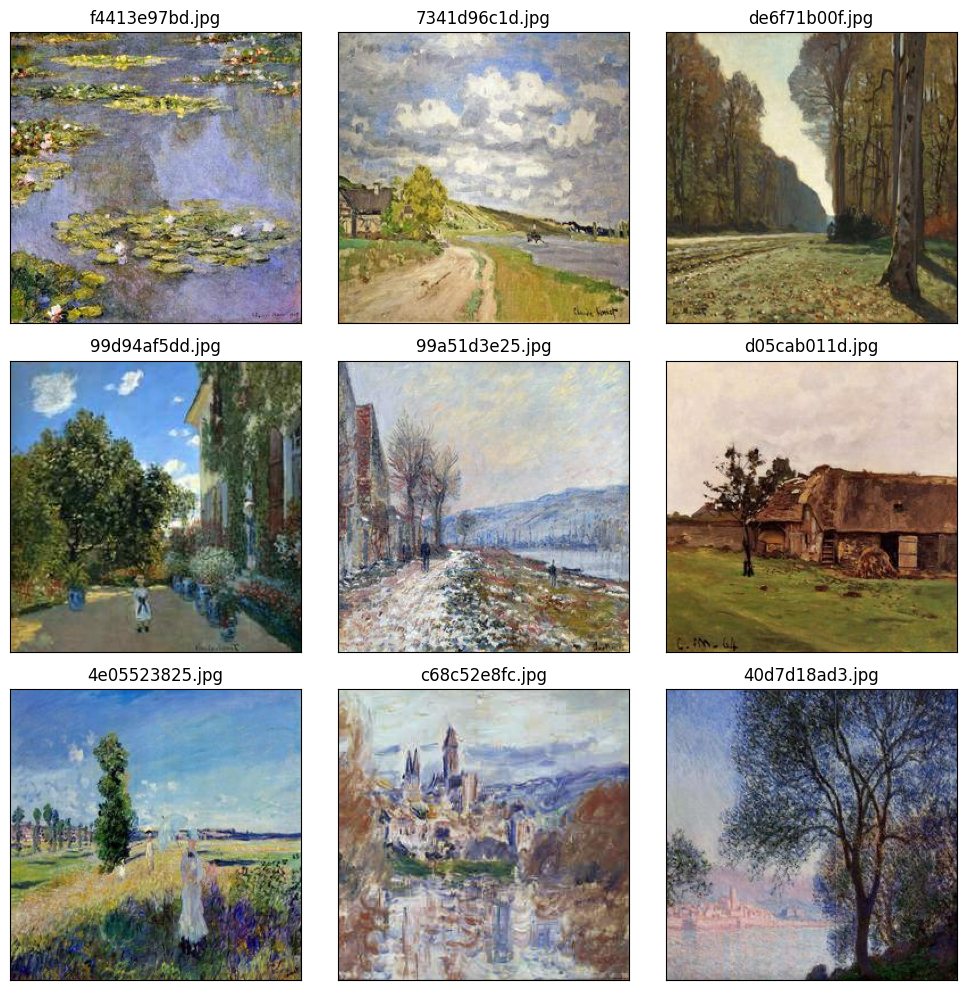

In [9]:
# Monet Paintings
display_images(Input + '/monet_jpg')

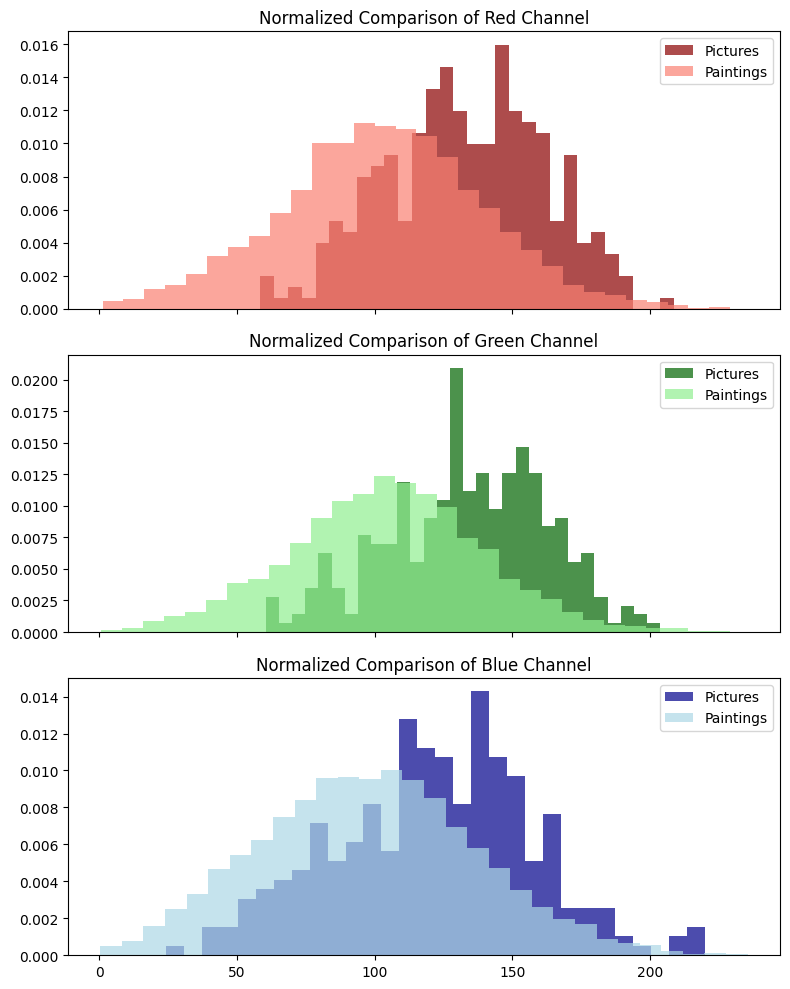

In [10]:
compare_image_colors_normalized(Input + '/monet_jpg', Input + '/photo_jpg')

## EDA Findings and Conclusions

Based on our exploratory data analysis, the following was clarified:

- **Dataset Format Confirmation**: The dataset contains both paintings and photographs in dual formats (JPEG and TFRecords), providing flexibility for different processing approaches

- **Dataset Size Verification**: The dataset composition was validated to include exactly 300 Monet paintings as specified in the competition guidelines. The photograph collection contains 7,038 images

- **Visual Quality Assessment**: Manual inspection of sample images from both collections confirmed that all paintings and photographs display appropriate visual characteristics and maintain expected quality standards without apparent corruption or artifacts

- **Color Intensity Analysis**: Comparative color distribution analysis revealed distinct stylistic differences between the two image categories. Photographs exhibit significantly higher color saturation and intensity on average, while Monet's paintings demonstrate a characteristically muted color palette that reflects the impressionist artistic style

# Model Architecture

This project employs a Deep Convolutional Generative Adversarial Network (DCGAN) architecture, which consists of two fundamental components working in adversarial opposition:

## Generator Network

The **Generator** serves as the creative component of the system, transforming random noise vectors into synthetic images that mimic Monet's artistic style. The generator's primary objective is to produce images of sufficient quality to deceive the discriminator into classifying them as authentic paintings. 

The generator architecture leverages a series of transposed convolutional layers (also known as deconvolutional layers) that progressively upscale the input noise vector through multiple stages, ultimately reconstructing it into a full-resolution 256×256 pixel image. This process enables the network to learn complex spatial hierarchies and artistic patterns characteristic of Monet's impressionist style.

## Discriminator Network

The **Discriminator** functions as a binary classifier and critic, tasked with distinguishing between authentic Monet paintings from the dataset and synthetic images generated by the generator network. The discriminator employs standard convolutional layers to systematically downsample input images while extracting increasingly abstract features, ultimately making a binary classification decision regarding image authenticity.

## Adversarial Training Process

The training methodology follows a competitive adversarial framework where both networks are optimized simultaneously but with opposing objectives:

- **Generator Optimization**: The generator seeks to maximize the discriminator's classification error rate by producing increasingly convincing synthetic paintings
- **Discriminator Optimization**: The discriminator aims to minimize its own error rate by improving its ability to detect synthetic images

This adversarial dynamic creates a continuous improvement cycle where both networks evolve their capabilities. The generator progressively produces more authentic Monet-style paintings, while the discriminator develops enhanced sensitivity to detect subtle differences between real and synthetic artworks.

The training process alternates between two phases: updating the discriminator using both real paintings and generator-produced images, followed by updating the generator based on discriminator feedback. This iterative process continues until the generator achieves sufficient quality to consistently produce Monet-style images that are difficult for the discriminator to classify correctly.

In [11]:
# Define the function to parse TFRecords
def _parse_function(proto):
    features = {
        'image': tf.io.FixedLenFeature([], tf.string),
    }
    parsed_features = tf.io.parse_single_example(proto, features)
    image = tf.io.decode_jpeg(parsed_features['image'], channels=3)
    image = tf.cast(image, tf.float32)
    image = (image - 127.5) / 127.5
    image = tf.reshape(image, [256, 256, 3])
    return image

# Load the dataset from TFRecords
def load_dataset(tfrecord_files, batch_size):
    dataset = tf.data.TFRecordDataset(tfrecord_files)
    dataset = dataset.map(_parse_function, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.shuffle(buffer_size=10000)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
    return dataset

I0000 00:00:1750541410.490331      19 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


E0000 00:00:1750541422.770255      19 meta_optimizer.cc:966] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1_2/dropout_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
I0000 00:00:1750541424.331843      62 cuda_dnn.cc:529] Loaded cuDNN version 90300


Epoch 1, gen_loss=20.3169, disc_loss=2.6558, time=34.73 sec


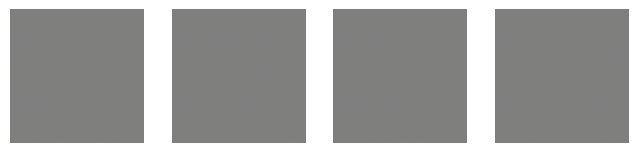

Epoch 20, gen_loss=12.7697, disc_loss=1.2152, time=7.90 sec


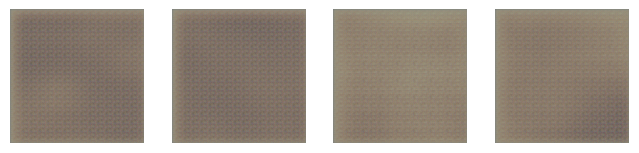

Epoch 40, gen_loss=13.8914, disc_loss=1.1408, time=7.89 sec


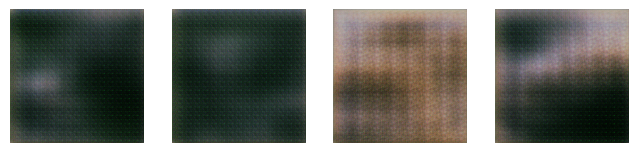

Epoch 60, gen_loss=14.1801, disc_loss=0.7877, time=7.87 sec


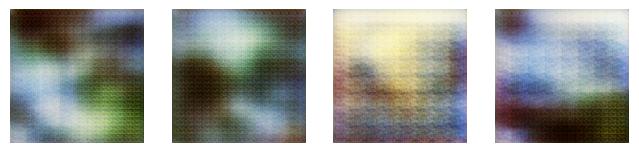

Epoch 80, gen_loss=14.2512, disc_loss=0.6212, time=7.89 sec


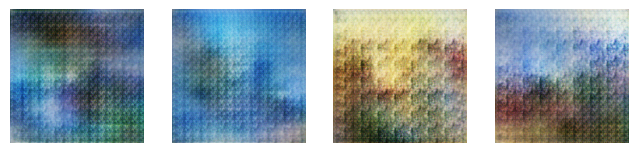

Epoch 100, gen_loss=15.0123, disc_loss=0.6682, time=7.90 sec


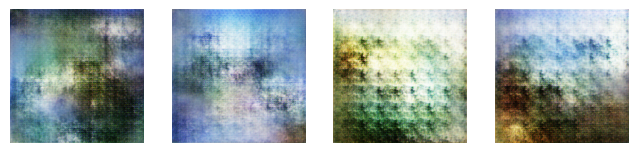

Epoch 120, gen_loss=15.3593, disc_loss=0.8071, time=7.89 sec


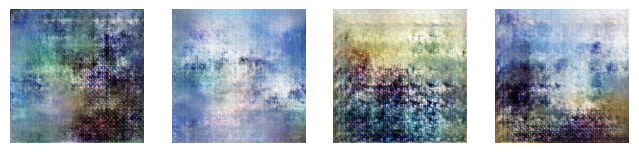

Epoch 140, gen_loss=15.6057, disc_loss=0.7490, time=7.89 sec


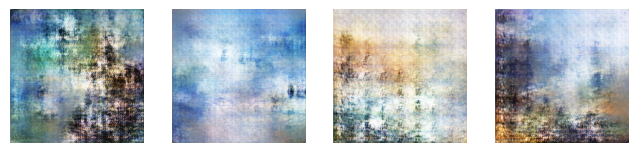

Epoch 160, gen_loss=16.0959, disc_loss=0.5380, time=7.91 sec


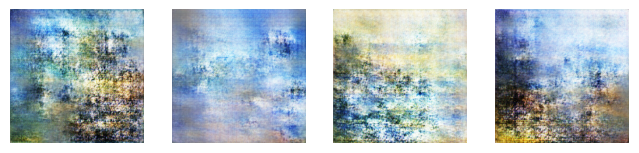

Epoch 180, gen_loss=16.3310, disc_loss=0.5186, time=7.90 sec


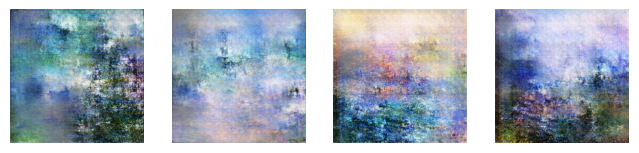

Epoch 200, gen_loss=16.4501, disc_loss=0.5044, time=7.89 sec


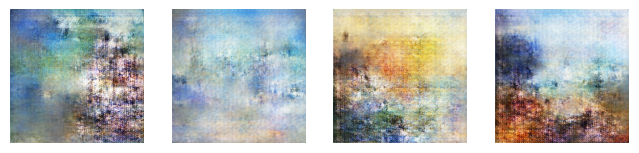

Epoch 220, gen_loss=16.2888, disc_loss=0.5016, time=7.90 sec


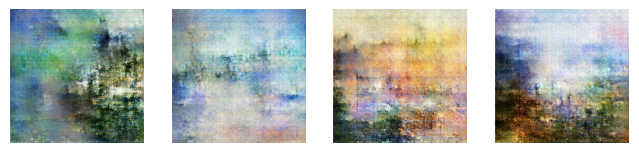

Epoch 240, gen_loss=16.9785, disc_loss=0.5047, time=7.90 sec


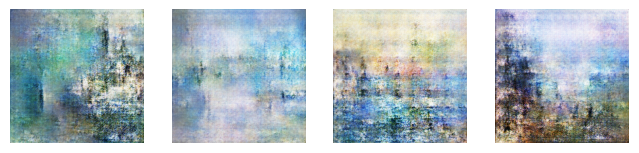

Epoch 260, gen_loss=16.8974, disc_loss=0.5162, time=7.89 sec


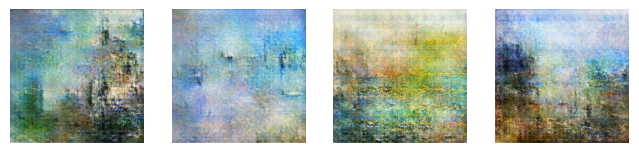

Epoch 280, gen_loss=16.9497, disc_loss=0.5162, time=7.89 sec


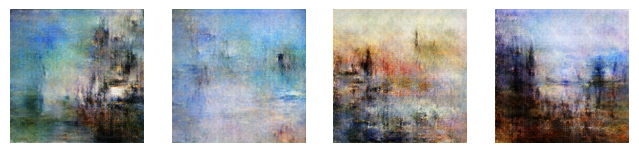

Epoch 300, gen_loss=16.9708, disc_loss=0.5829, time=7.88 sec


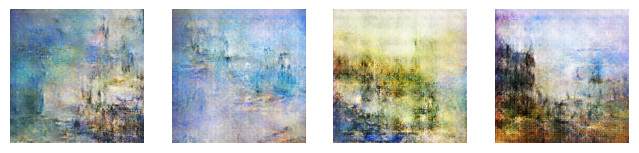

Epoch 320, gen_loss=17.0552, disc_loss=0.5114, time=7.88 sec


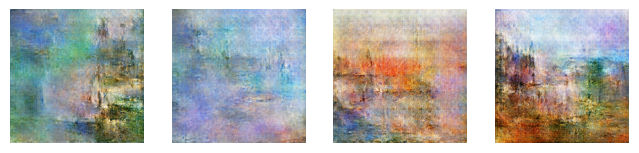

Epoch 340, gen_loss=17.0209, disc_loss=0.5172, time=7.89 sec


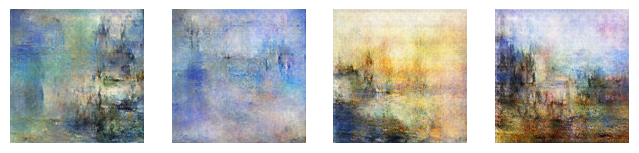

Epoch 360, gen_loss=16.7660, disc_loss=0.4860, time=7.91 sec


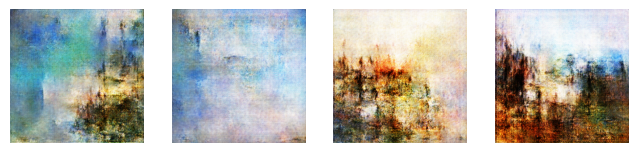

Epoch 380, gen_loss=17.0494, disc_loss=0.5347, time=7.87 sec


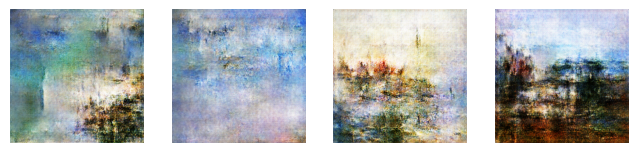

Epoch 400, gen_loss=17.0269, disc_loss=0.6605, time=7.90 sec


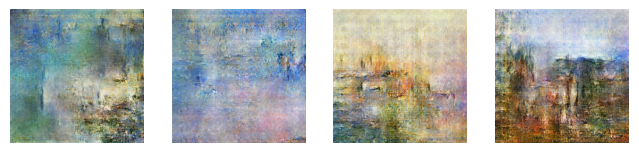

Epoch 420, gen_loss=17.2388, disc_loss=0.4432, time=7.89 sec


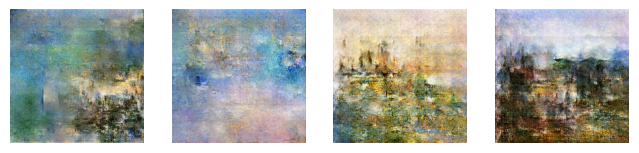

Epoch 440, gen_loss=17.2993, disc_loss=0.4524, time=7.90 sec


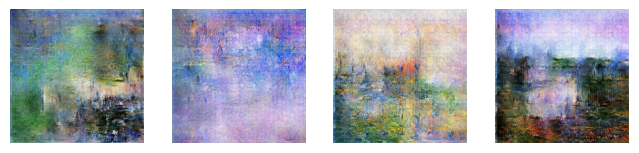

Epoch 460, gen_loss=17.0629, disc_loss=0.4654, time=7.90 sec


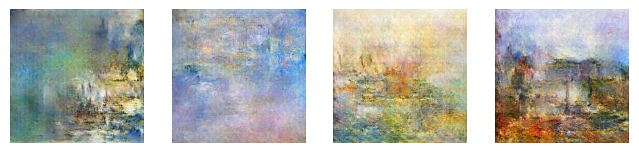

Epoch 480, gen_loss=16.9313, disc_loss=0.4403, time=7.89 sec


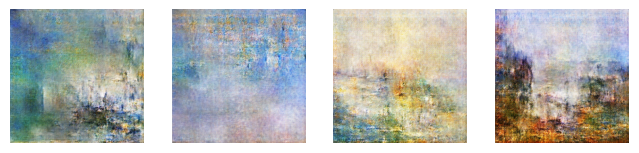

Epoch 500, gen_loss=17.3453, disc_loss=0.5230, time=7.89 sec


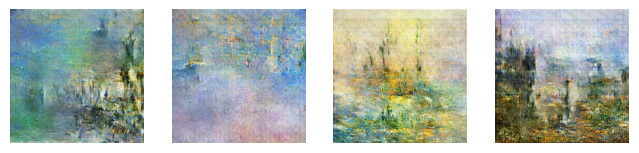

Epoch 520, gen_loss=16.8281, disc_loss=0.4645, time=7.88 sec


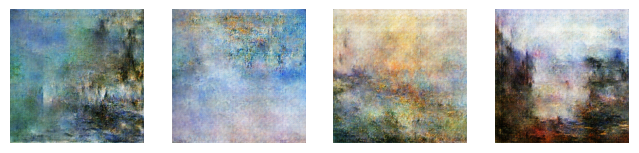

Epoch 540, gen_loss=17.1132, disc_loss=0.4392, time=7.87 sec


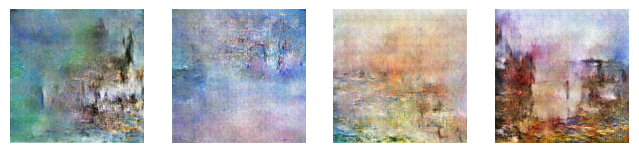

Epoch 560, gen_loss=16.6635, disc_loss=0.4632, time=7.90 sec


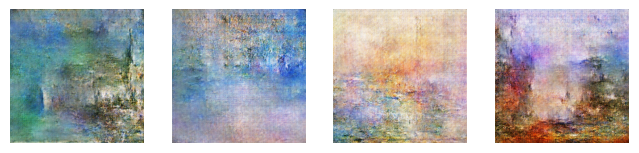

Epoch 580, gen_loss=17.1946, disc_loss=0.4837, time=7.90 sec


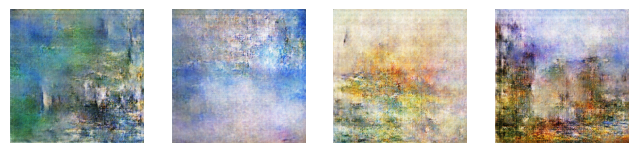

Epoch 600, gen_loss=16.8379, disc_loss=0.4655, time=7.87 sec


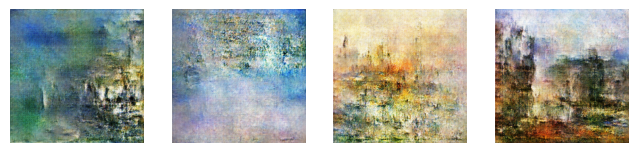

Epoch 620, gen_loss=17.2626, disc_loss=0.4822, time=7.89 sec


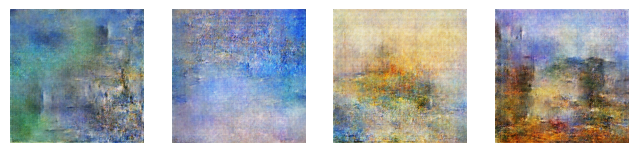

Epoch 640, gen_loss=16.9923, disc_loss=0.4960, time=7.91 sec


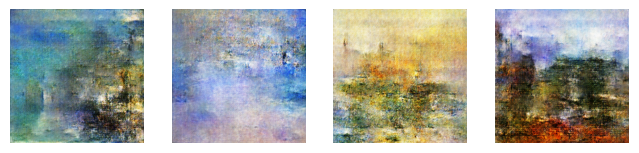

Epoch 660, gen_loss=17.2679, disc_loss=0.4579, time=7.88 sec


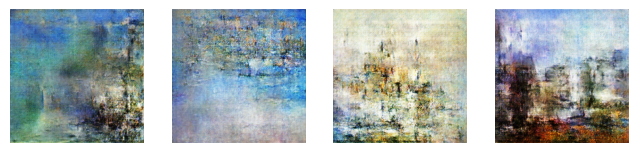

Epoch 680, gen_loss=17.3102, disc_loss=0.4720, time=7.89 sec


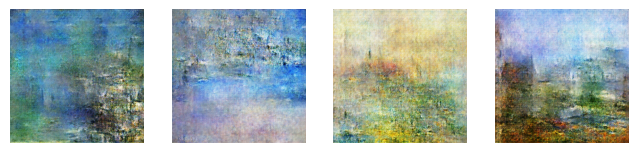

Epoch 700, gen_loss=17.3495, disc_loss=0.4683, time=7.89 sec


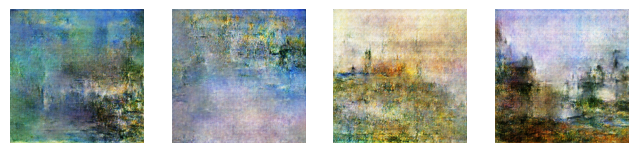

Epoch 720, gen_loss=17.1969, disc_loss=0.5417, time=7.89 sec


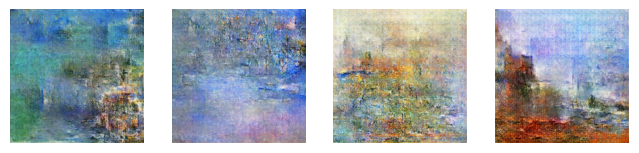

Epoch 740, gen_loss=17.4142, disc_loss=0.4484, time=7.90 sec


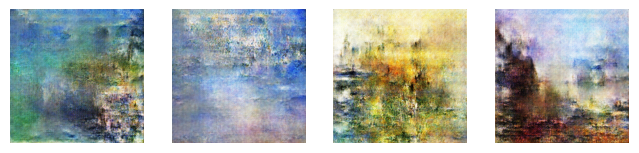

Epoch 760, gen_loss=16.8511, disc_loss=0.4580, time=7.86 sec


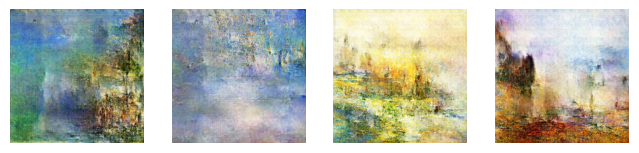

Epoch 780, gen_loss=17.2983, disc_loss=0.4502, time=7.87 sec


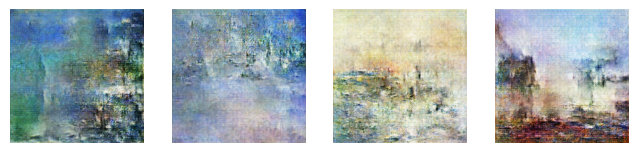

Epoch 800, gen_loss=17.1129, disc_loss=0.4507, time=7.88 sec


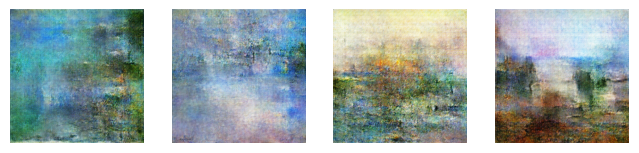

Epoch 820, gen_loss=17.1950, disc_loss=0.4809, time=7.90 sec


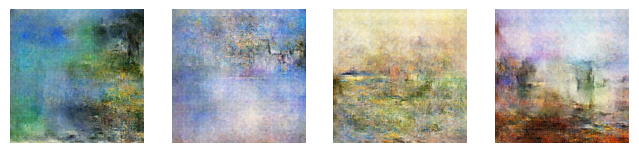

Epoch 840, gen_loss=17.2339, disc_loss=0.4393, time=7.89 sec


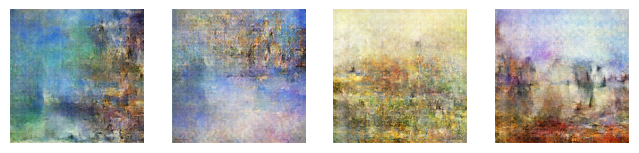

Epoch 860, gen_loss=17.0721, disc_loss=0.4647, time=7.90 sec


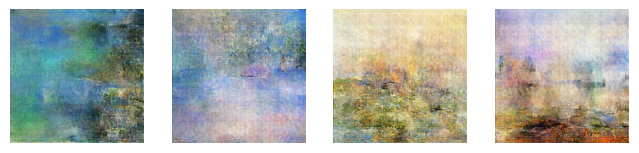

Epoch 880, gen_loss=17.1523, disc_loss=0.4600, time=7.89 sec


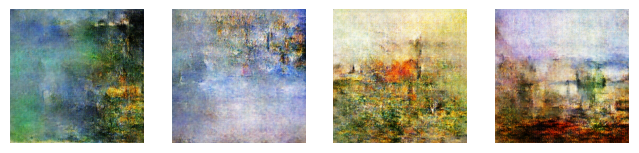

Epoch 900, gen_loss=16.9256, disc_loss=0.4672, time=7.90 sec


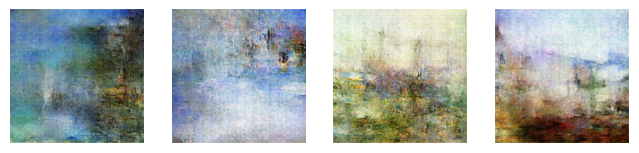

Epoch 920, gen_loss=17.4244, disc_loss=0.4757, time=7.90 sec


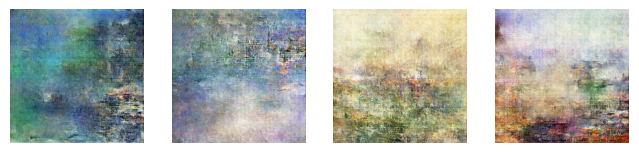

Epoch 940, gen_loss=17.4451, disc_loss=0.4272, time=7.89 sec


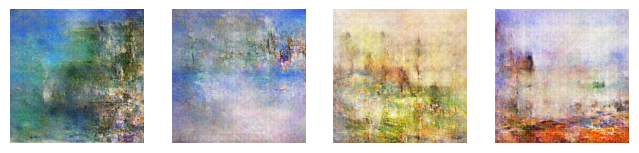

Epoch 960, gen_loss=17.3329, disc_loss=0.4648, time=7.89 sec


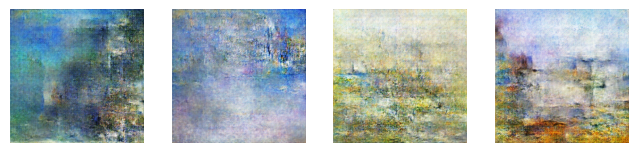

Epoch 980, gen_loss=17.1641, disc_loss=0.4456, time=7.90 sec


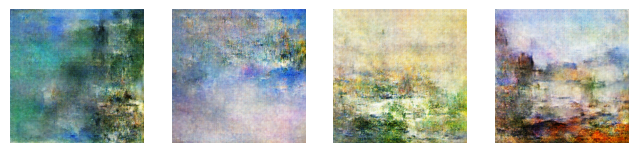

Epoch 1000, gen_loss=16.9708, disc_loss=0.4533, time=7.90 sec


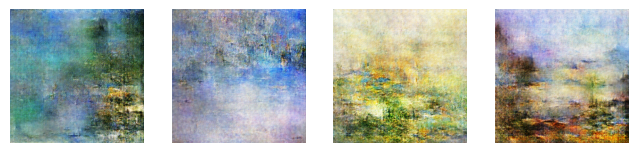

Epoch 1020, gen_loss=17.5358, disc_loss=0.5004, time=7.90 sec


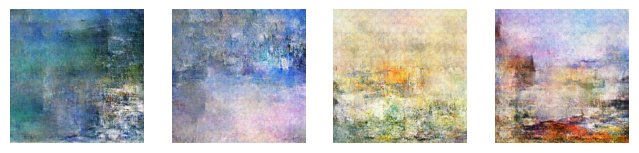

Epoch 1040, gen_loss=16.8954, disc_loss=0.4510, time=7.89 sec


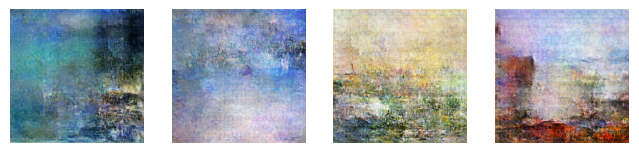

Epoch 1060, gen_loss=16.8697, disc_loss=0.4940, time=7.91 sec


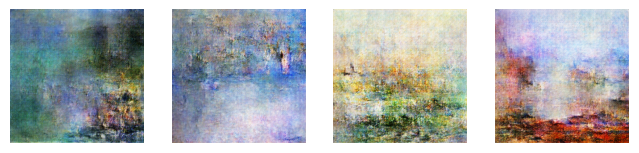

Epoch 1080, gen_loss=17.4017, disc_loss=0.4975, time=7.90 sec


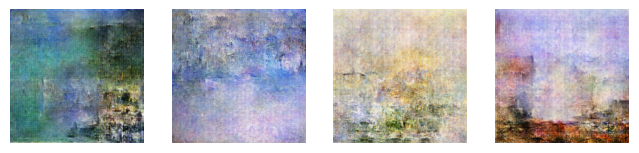

Epoch 1100, gen_loss=17.1831, disc_loss=0.4549, time=7.91 sec


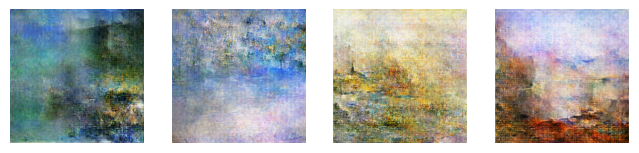

Epoch 1120, gen_loss=17.1186, disc_loss=0.6025, time=7.89 sec


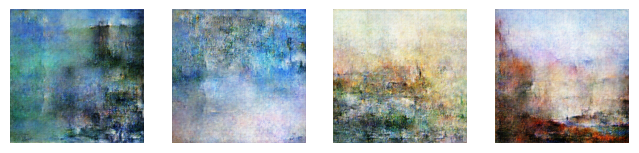

Epoch 1140, gen_loss=17.4574, disc_loss=0.4721, time=7.89 sec


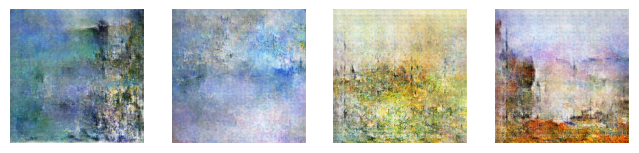

Epoch 1160, gen_loss=17.2429, disc_loss=0.4562, time=7.89 sec


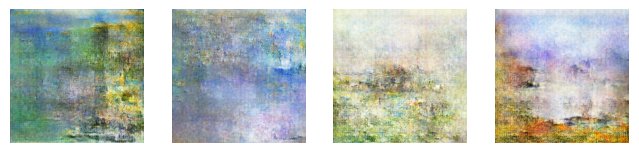

Epoch 1180, gen_loss=16.9159, disc_loss=0.4509, time=7.84 sec


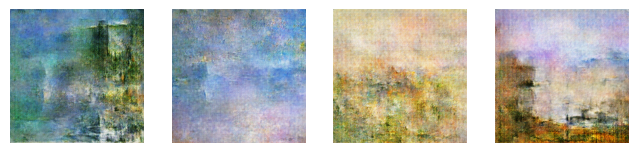

Epoch 1200, gen_loss=17.2079, disc_loss=0.4756, time=7.89 sec


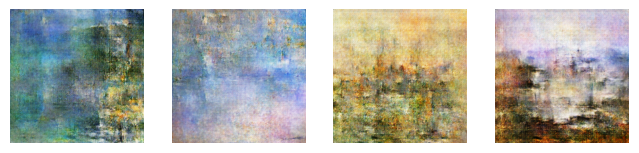

Epoch 1220, gen_loss=17.1357, disc_loss=0.4939, time=7.87 sec


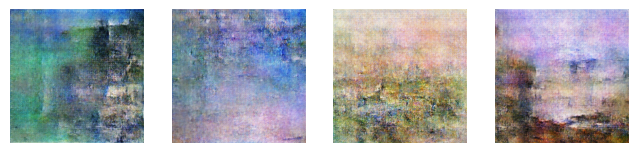

Epoch 1240, gen_loss=17.0609, disc_loss=0.5011, time=7.90 sec


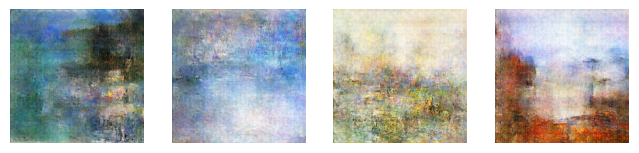

Epoch 1260, gen_loss=17.1711, disc_loss=0.4228, time=7.87 sec


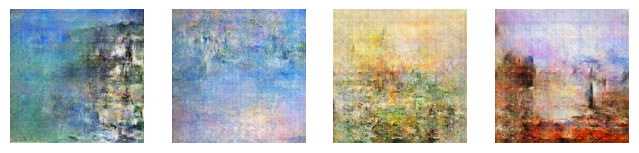

Epoch 1280, gen_loss=17.0847, disc_loss=0.4818, time=7.89 sec


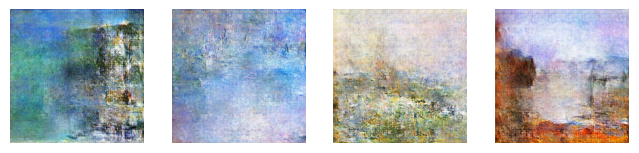

Epoch 1300, gen_loss=17.3662, disc_loss=0.4866, time=7.86 sec


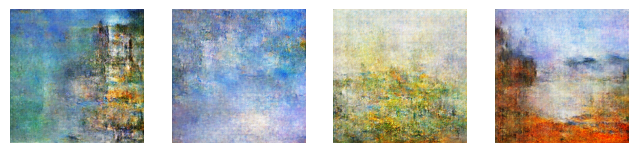

Epoch 1320, gen_loss=17.1133, disc_loss=0.4470, time=7.88 sec


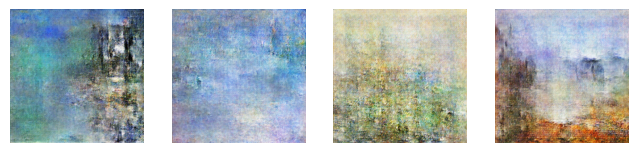

Epoch 1340, gen_loss=16.8982, disc_loss=0.8484, time=7.88 sec


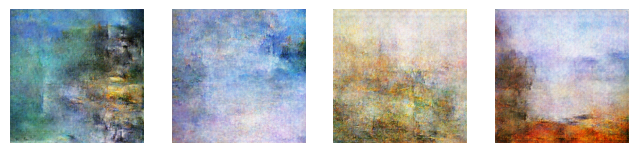

Epoch 1360, gen_loss=16.7201, disc_loss=0.4642, time=7.84 sec


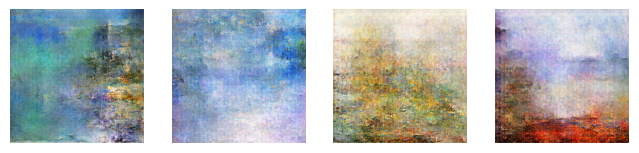

Epoch 1380, gen_loss=17.2091, disc_loss=0.4274, time=7.91 sec


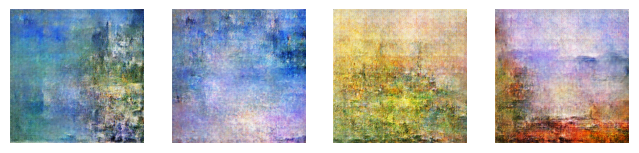

Epoch 1400, gen_loss=16.9680, disc_loss=0.4453, time=7.88 sec


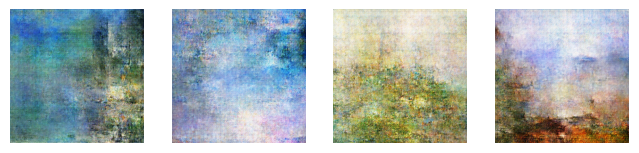

Epoch 1420, gen_loss=17.2826, disc_loss=0.4329, time=7.90 sec


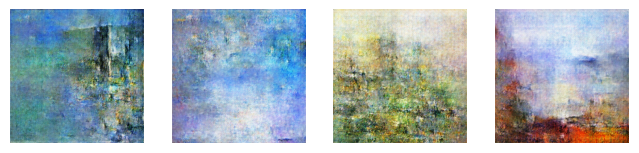

Epoch 1440, gen_loss=17.1821, disc_loss=0.4615, time=7.90 sec


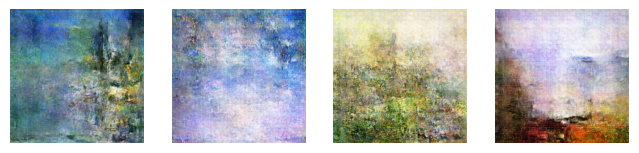

Epoch 1460, gen_loss=17.1381, disc_loss=0.4788, time=7.91 sec


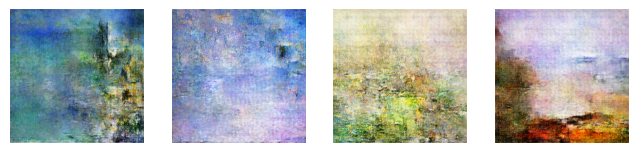

Epoch 1480, gen_loss=16.6810, disc_loss=0.4794, time=7.90 sec


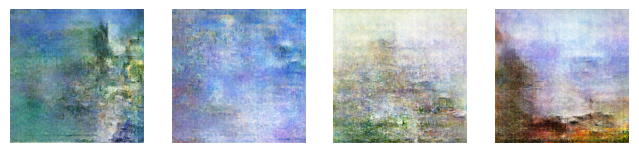

Epoch 1500, gen_loss=17.4466, disc_loss=0.7645, time=7.91 sec


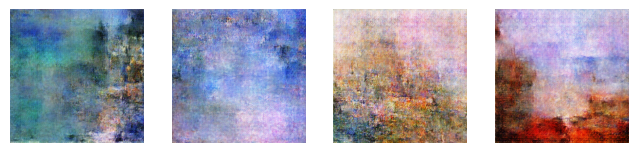

In [12]:
# Improved Generator model with better architecture
def make_generator_model():
    model = tf.keras.Sequential([
        layers.Input(shape=(100,)),  # Fix input_shape warning
        layers.Dense(8*8*1024, use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Reshape((8, 8, 1024)),
        layers.Conv2DTranspose(512, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(256, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        # Add residual-like skip connection for better gradient flow
        layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        # Additional conv layer for more detail
        layers.Conv2D(32, (3, 3), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh')
    ])
    return model

# Improved Discriminator model with better regularization
def make_discriminator_model():
    model = tf.keras.Sequential([
        layers.Input(shape=[256, 256, 3]),  # Fix input_shape warning
        layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(0.2),
        layers.Dropout(0.3),
        layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(0.2),
        layers.Dropout(0.3),
        layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(0.2),
        layers.Dropout(0.3),
        layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(0.2),
        layers.Dropout(0.4),  # Slightly higher dropout for regularization
        layers.Conv2D(1024, (5, 5), strides=(2, 2), padding='same'),  # Extra layer for more capacity
        layers.LeakyReLU(0.2),
        layers.Dropout(0.4),
        layers.Flatten(),
        layers.Dense(1)
    ])
    return model

# Load VGG19 for perceptual loss
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet', input_shape=(256, 256, 3))
vgg.trainable = False
# Use multiple layers for richer feature representation
feature_extractor = tf.keras.Model(
    inputs=vgg.input,
    outputs=[vgg.get_layer('block2_conv2').output,
             vgg.get_layer('block3_conv3').output,
             vgg.get_layer('block4_conv3').output]
)

def perceptual_loss(real_images, fake_images):
    # Normalize images to [0,1] range for VGG
    real_norm = (real_images + 1.0) / 2.0
    fake_norm = (fake_images + 1.0) / 2.0
    
    real_features = feature_extractor(real_norm)
    fake_features = feature_extractor(fake_norm)
    
    loss = 0.0
    for real_feat, fake_feat in zip(real_features, fake_features):
        loss += tf.reduce_mean(tf.abs(real_feat - fake_feat))
    
    return loss / len(real_features)

# Define improved loss functions
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output, real_images, fake_images):
    adversarial_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    perceptual_loss_value = perceptual_loss(real_images, fake_images)
    return adversarial_loss + 5.0 * perceptual_loss_value  # Weighted perceptual loss

def discriminator_loss(real_output, fake_output):
    # Label smoothing for more stable training
    real_loss = cross_entropy(tf.ones_like(real_output) * 0.9, real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

@tf.function
def train_step(images, generator, discriminator, generator_optimizer, discriminator_optimizer):
    noise = tf.random.normal([tf.shape(images)[0], 100])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output, images, generated_images)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    return gen_loss, disc_loss

def train(dataset, epochs, generator, discriminator, generator_optimizer, discriminator_optimizer):
    for epoch in range(epochs):
        start = time.time()
        
        gen_loss_sum = 0.0
        disc_loss_sum = 0.0
        batch_count = 0

        for image_batch in dataset:
            gen_loss, disc_loss = train_step(image_batch, generator, discriminator, generator_optimizer, discriminator_optimizer)
            gen_loss_sum += gen_loss
            disc_loss_sum += disc_loss
            batch_count += 1

        gen_loss_avg = gen_loss_sum / batch_count
        disc_loss_avg = disc_loss_sum / batch_count
        
        if (epoch + 1) == 1 or (epoch + 1) % 20 == 0:
            print(f'Epoch {epoch+1}, gen_loss={gen_loss_avg:.4f}, disc_loss={disc_loss_avg:.4f}, time={time.time()-start:.2f} sec')
            generate_and_save_images(generator, epoch + 1, seed)

def generate_and_save_images(model, epoch, test_input):
    predictions = model(test_input, training=False)
    fig = plt.figure(figsize=(8, 8))

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        img = (predictions[i, :, :, :] * 127.5 + 127.5).numpy().astype('uint8')
        plt.imshow(img)
        plt.axis('off')

    plt.show()

BATCH_SIZE = 32
tfrecord_files = [
    Input + '/monet_tfrec/monet00-60.tfrec',
    Input + '/monet_tfrec/monet04-60.tfrec',
    Input + '/monet_tfrec/monet08-60.tfrec',
    Input + '/monet_tfrec/monet12-60.tfrec',
    Input + '/monet_tfrec/monet16-60.tfrec'
]
dataset = load_dataset(tfrecord_files, BATCH_SIZE)

generator = make_generator_model()
discriminator = make_discriminator_model()

# Improved optimizers with different learning rates
generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.0, beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(4e-4, beta_1=0.0, beta_2=0.9)

num_examples_to_generate = 4
seed = tf.random.normal([num_examples_to_generate, 100])

# Start Training
train(dataset, 1500, generator, discriminator, generator_optimizer, discriminator_optimizer)

# Kaggle submission

In [13]:
def generate_and_save_images(model, total_images, directory, batch_size=10):
    if not os.path.exists(directory):
        os.makedirs(directory)  # Ensure the directory exists

    for batch_start in range(0, total_images, batch_size):
        batch_end = min(batch_start + batch_size, total_images)
        num_images = batch_end - batch_start
        noise = tf.random.normal([num_images, 100])  # Generate different noises for each batch
        predictions = model(noise, training=False)

        for i, img in enumerate(predictions):
            img = (img * 127.5 + 127.5).numpy().astype('uint8')
            image = Image.fromarray(img)
            image.save(f"{directory}/image_{batch_start+i+1:03d}.jpg", 'JPEG')  # Save each image as JPEG

            # Directory where images will be saved
output_dir = '../images'

# After training, generate and save 7000 images in JPEG format
generate_and_save_images(generator, 7000, output_dir)

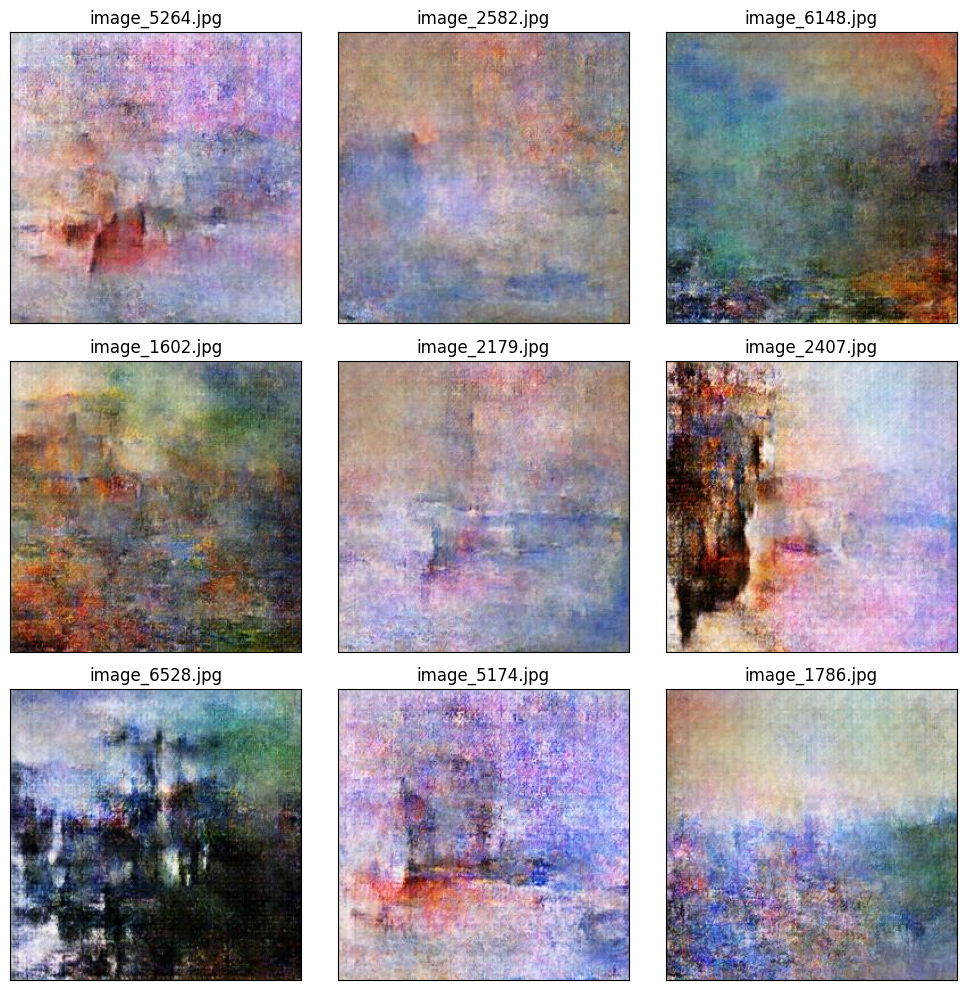

In [14]:
# Display generated images, to validate the file contents
path = '../images'
display_images(path)

In [15]:
# Create zip-file
shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

'/kaggle/working/images.zip'

In [16]:
# Validate that a file has been created for submission
!ls

images.zip  __notebook__.ipynb


# Results and Conclusion

## Project Outcomes

This project successfully demonstrates the feasibility of developing a Generative Adversarial Network capable of producing images in Claude Monet's distinctive artistic style. The implemented DCGAN architecture has shown promising results in learning and replicating certain fundamental characteristics of impressionist painting techniques.

## Model Performance Analysis

### Strengths
The trained GAN model achieved notable success in **color reproduction**, accurately capturing Monet's characteristic color palettes, tonal variations, and the subtle color relationships that define his impressionist style. The generated images demonstrate a clear understanding of the atmospheric qualities and color harmonies present in authentic Monet paintings.

### Limitations
Despite the successful color learning, the model exhibits significant limitations in **compositional and figurative elements**. Under the current training regime, human observers can readily distinguish between authentic Monet paintings and GAN-generated images. The synthetic paintings lack the sophisticated compositional structure, subject matter coherence, and nuanced brushwork patterns that characterize Monet's masterworks.

## Future Considerations

### Training Duration Impact
Extended training periods may potentially improve the model's ability to capture more complex figurative aspects of Monet's style. Additional computational resources and longer training cycles could allow the network to learn more sophisticated spatial relationships and compositional elements.

### Fundamental Limitations
However, it remains uncertain whether current GAN architectures possess the inherent capacity to fully capture the abstract conceptual and compositional elements that define Monet's artistic genius. The challenge extends beyond pattern recognition to encompass higher-order artistic principles that may require more advanced architectural innovations or hybrid approaches combining multiple AI techniques.

## Conclusion
While this project validates the potential of GANs for artistic style transfer, it also highlights the complexity of replicating master-level artistic creation.